In [1]:
import scipy.optimize as scop
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interactive
import scipy.io as io
%matplotlib inline
fig_size = (8, 4)


In [2]:
def bio_path(filedir, mu, a, beta, g):
    from glob import glob
    path = filedir+'/' + \
        'cVegFin_1000x1000_Mu_%.3f_Alpha_%.3f_Beta_%.3f_G_%.2f.mat' % (mu, a, beta, g)
    filepath = glob(path)
    return(filepath)


def read_bio(filepath):
    import scipy.io as io
    mat = io.loadmat(filepath)
    bio = mat['BioFins']
    bioend = bio[:,:,-1]
    bioend = np.array(bioend)
    return bioend

def filloutliar(array):
    import matlab.engine
    import matlab
    eng = matlab.engine.start_matlab()
    array2 = matlab.double(array.tolist())
    bio_fill = eng.filloutliers(array2,'nearest','mean')
    bio_fill = np.array(bio_fill)
    return(bio_fill)

In [3]:
filedir = '/home/swang/remote/my_scratch/Data/statistics/cveg'
#filedir = '/Net/Groups/BGI/scratch/swang/Data/statistics/cveg'
mu = 0.01
a = 1.0
beta = 0.03
g = 0.03
filelist = bio_path(filedir, mu, a, beta, g)
bio = read_bio(filelist[0])
bio_fill = filloutliar(bio)


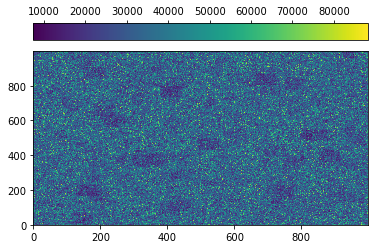

In [4]:

x = np.arange(1000)
y = np.arange(1000)
X,Y =  np.meshgrid(x,y)

fig,ax=plt.subplots(1,1)
im = ax.pcolormesh(X,Y,bio_fill,vmin=np.min(bio_fill), vmax=np.max(bio_fill), shading='auto')
fig.colorbar(im,location='top')

In [5]:
p1 = np.array([0.01,1.0,0.03])
p2 = np.array([0.03,1.0,0.03])
p3 = np.array([0.05,1.0,0.03])


p4 = np.array([0.01,1.0,0.03])
p5 = np.array([0.01,1.4,0.03])
p6 = np.array([0.01,1.8,0.03])

p7 = np.array([0.01,1.0,0.03])
p8 = np.array([0.01,1.0,0.2])
p9 = np.array([0.01,1.0,0.5])

ps = np.row_stack((p1,p2,p3,p4,p5,p6,p7,p8,p9))
ps[0]


array([0.01, 1.  , 0.03])

/tmp/ipykernel_8021/3019771386.py:23: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  images.append(axs[i,j].pcolormesh(X,Y,bio_fill,cmap='viridis_r'))


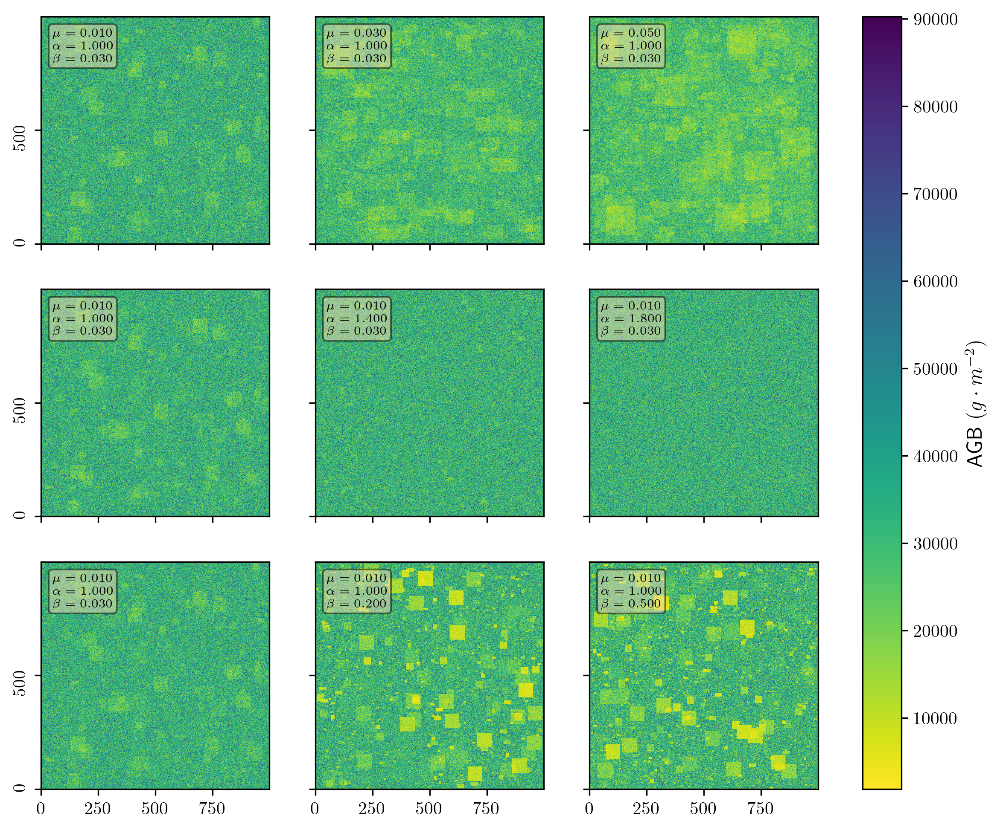

In [6]:
from matplotlib import colors
plt.rcParams['text.usetex'] = True

fig, axs = plt.subplots(3,3,figsize=(9,8),dpi=300)
#fig.suptitle('Multiple biomass')

index=0
images=[]
for i in range(3):
    for j in range(3):
        p = ps[index]
        ## import data
        filedir = '/home/swang/remote/my_scratch/Data/statistics/cveg'
        mu = p[0]
        a = p[1]
        beta = p[2]
        g = 0.03
        filelist = bio_path(filedir, mu, a, beta, g)
        bio = read_bio(filelist[0])
        bio_fill = filloutliar(bio)
        # bio_fill = np.zeros([1000,1000])
        ## plot data
        images.append(axs[i,j].pcolormesh(X,Y,bio_fill,cmap='viridis_r'))
        axs[i, j].label_outer()
        
        #text contains parameter
        props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
        textstr = '\n'.join((r'$\mu=%.3f$'%(mu,),
                             r'$\alpha=%.3f$'%(a,),
                             r'$\beta=%.3f$'%(beta,))
                            )
        axs[i, j].text(0.05, 0.95, textstr, transform=axs[i,j].transAxes, fontsize=7,
        verticalalignment='top', bbox=props)
        axs[i, j].locator_params(axis='y', nbins=3)
        for tick in axs[i,j].get_yticklabels():
            tick.set_rotation(90)
        
        ###
        index+=1
        
# Find the min and max of all colors for use in setting the color scale.
vmin = min(image.get_array().min() for image in images)
vmax = max(image.get_array().max() for image in images)
norm = colors.Normalize(vmin=vmin, vmax=vmax)
for im in images:
    im.set_norm(norm)

cbar = fig.colorbar(images[0], ax=axs, orientation='vertical', fraction=.08,pad=0.05)
cbar.set_label(r"AGB "
               r"$(g\cdot m^{-2})$",
               fontsize=12)
        
#cbar.set_ticklabels()
#cbar.set_label()

#plt.subplots_adjust(wspace=0.2, hspace=0.4)
# def update(changed_image):
#     for im in images:
#         if (changed_image.get_cmap() != im.get_cmap()
#                 or changed_image.get_clim() != im.get_clim()):
#             im.set_cmap(changed_image.get_cmap())
#             im.set_clim(changed_image.get_clim())

# for im in images:
#     im.callbacks.connect('changed', update)
#plt.savefig('./AGB.png',bbox_inches='tight')
plt.show()
        

(array([5.88760e+04, 1.43898e+05, 2.81479e+05, 2.48137e+05, 1.40538e+05,
        7.10270e+04, 3.54660e+04, 1.76110e+04, 2.89800e+03, 7.00000e+01]),
 array([ 1878.16007364, 10584.34405072, 19290.52802779, 27996.71200486,
        36702.89598193, 45409.079959  , 54115.26393608, 62821.44791315,
        71527.63189022, 80233.81586729, 88939.99984436]),
 <BarContainer object of 10 artists>)

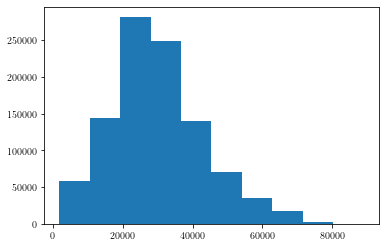

In [7]:
fig,ax=plt.subplots(1,1)
type(bio_fill)
ax.hist(bio_fill.flatten())

In [13]:
images[0].get_array().reshape(images[0]._meshWidth, images[0]._meshHeight)

masked_array(
  data=[[27328.86047473, 21620.16897146, 30245.97065899, ...,
         29661.24931647, 47687.67111978, 29909.58649176],
        [18682.40979675, 28358.93118915, 22768.32402599, ...,
         29659.76337769, 35478.04728066, 42202.73415154],
        [59246.91505801, 30652.8878933 , 34268.72866887, ...,
         30321.69014901, 24698.2440758 , 52983.06351879],
        ...,
        [25641.65444536, 20471.9956789 , 36623.1107746 , ...,
         22746.94876828, 19426.16412114, 34408.34774121],
        [40192.37962505, 35712.38533548, 36693.02605146, ...,
         37331.79434734, 37194.86881229, 56524.11672156],
        [25983.25256331, 35712.38533548, 33366.44953611, ...,
         48706.11372098, 30667.3863894 , 21724.9494259 ]],
  mask=False,
  fill_value=1e+20)

In [9]:
from mpl_toolkits.axes_grid1 import ImageGrid
def demo_grid_with_single_cbar(fig,vmin,vmax):
    """
    A grid of 2x2 images with a single colorbar
    """
    norm = colors.Normalize(vmin=vmin, vmax=vmax)
    for im in images:
        im.set_norm(norm)
        
    grid = ImageGrid(fig, 111,  # similar to subplot(142)
                     nrows_ncols=(3, 3),
                     axes_pad=0.0,
                     share_all=True,
                     label_mode="L",
                     cbar_location="right",
                     cbar_mode="single",
                     )
    i=0

    for ax in grid:
        p = ps[i]
        mu = p[0]
        a = p[1]
        beta = p[2]
        g = 0.03
        
        img = images[i].get_array().reshape(images[i]._meshWidth, images[i]._meshHeight)
        im = ax.imshow(img,cmap='viridis_r')
        props = dict(boxstyle='round', facecolor='wheat', alpha=0.9)
        textstr = '\n'.join((r'$\mu=%.2f$'%(mu,),
                             r'$\alpha=%.2f$'%(a,),
                             r'$\beta=%.2f$'%(beta,))
                            )
        ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', bbox=props)
        ax.locator_params(axis='y', nbins=3)
        norm = colors.Normalize(vmin=vmin, vmax=vmax)
        im.set_norm(norm)
        for tick in ax.get_yticklabels():
            tick.set_rotation(90)
                
        i=i+1
    grid.axes_llc.set_yticks([500])
    cbar = grid.cbar_axes[0].colorbar(im,extend='max')
    cbar.set_label(r"AGB "
               r"$(gC\cdot m^{-2})$",
               fontsize=18)


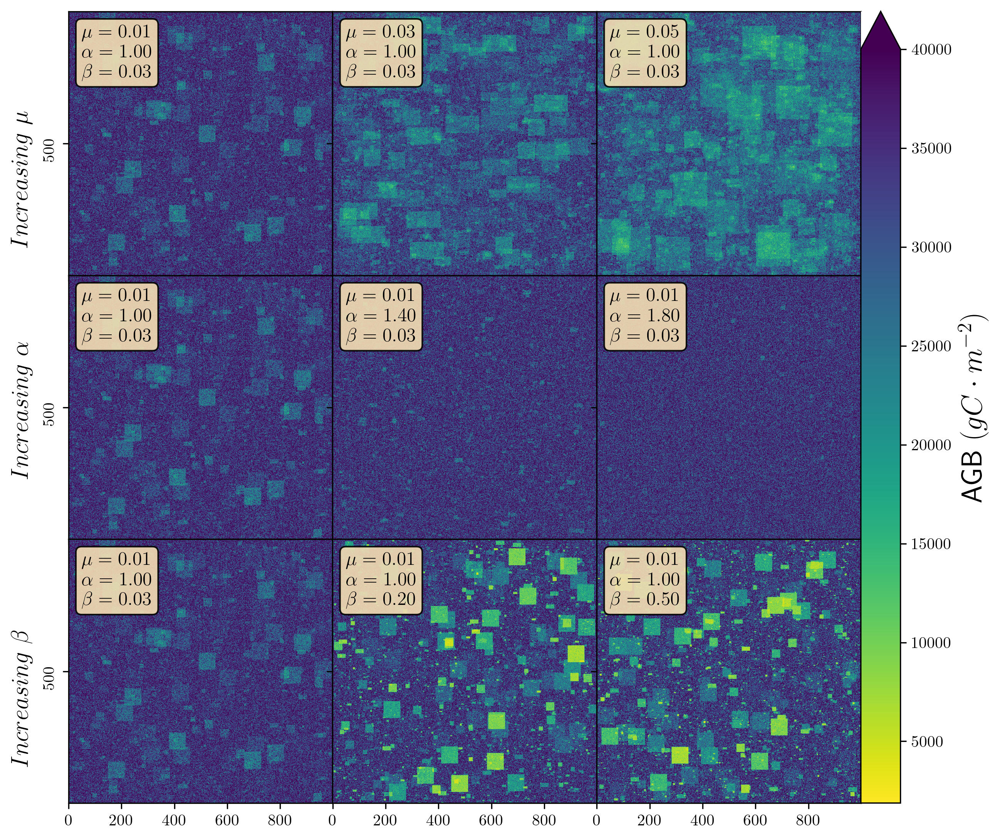

In [10]:
vmin = min(image.get_array().min() for image in images)
vmax = max(image.get_array().max() for image in images)

fig = plt.figure(figsize=(8, 10),dpi=300)
fig.subplots_adjust(left=0.05, right=0.95)
#bbox = {'fc': '0.8', 'pad': 0}
fig.text(0.0, 0.25, r'$Increasing\ \beta$',  {'ha': 'center', 'va': 'center'}, fontsize = 15,rotation=90) #'bbox': bbox
fig.text(0.0, 0.50, r'$Increasing\ \alpha$',  {'ha': 'center', 'va': 'center'}, fontsize = 15,rotation=90) #'bbox': bbox
fig.text(0.0, 0.70, r'$Increasing\ \mu$',  {'ha': 'center', 'va': 'center'}, fontsize = 15,rotation=90) #'bbox': bbox
demo_grid_with_single_cbar(fig,vmin,40000)
plt.savefig('/Net/Groups/BGI/people/swang/Jupyter/paper1_plot/ste-sta biomass/AGB_dense_max40k.png',bbox_inches='tight')
plt.show()